<h1>Resizing Images and Adding Logos Using the Pillow Package</h1>

In [5]:
!pip install pillow


[notice] A new release of pip is available: 25.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


   ---------------------------------------- 0.0/4.5 MB ? eta -:--:--
   ---------------------------------------- 4.5/4.5 MB 32.9 MB/s eta 0:00:00



[notice] A new release of pip is available: 25.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
# Upload local files using this Kelby. Control+Enter will run a block of code.
try:
    from google.colab import files
    uploaded = files.upload()

    for fname in uploaded.keys():
        print(f"User uploaded file: {fname}")
except ImportError:
    print("Not running in Google Colab. Skipping file upload cell.")


<h1>Resizing a Logo</h1>

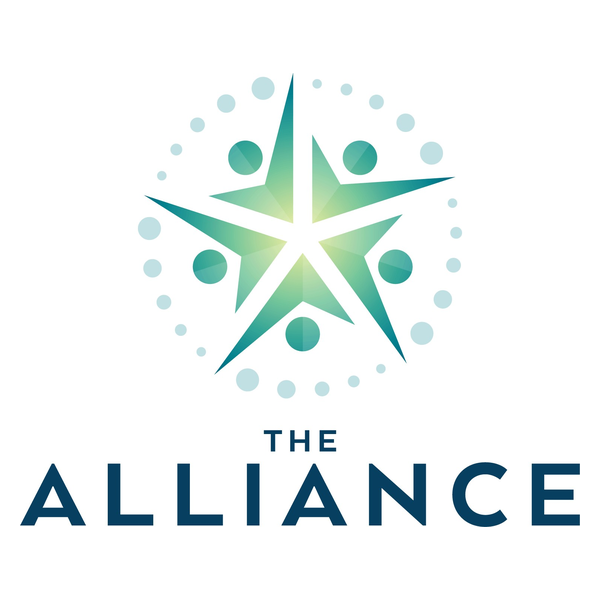

In [11]:
from PIL import Image, ImageOps

# Import the original image - upload to JN. This was 1500x1216 to start.
img = Image.open("The-Alliance-Logo.jpg")

# Resize while preserving aspect ratio - I want this smaller than my canvas because the text in the orginal was very close to the edges.
img.thumbnail((560, 560), Image.LANCZOS)

# Create a new blank canvas of the target size
canvas = Image.new("RGB", (600, 600), (255, 255, 255))  # white background

# Center the resized image on the canvas
x = (600 - img.width) // 2
y = (600 - img.height) // 2
canvas.paste(img, (x, y))

# Save the result
# quality is for formats that use lossy compression (jpeg (1-95), webp(1-100)): 1 = low quality/small file, 95 = high quality/large file
# optimize is for lossless formats (png): true = smaller, more efficient, but slower
# compress_level is also for lossless: 0 = no compression (fastest, biggest file, 9 = maximum compression (slowest, smallest file)

canvas.save("resized_alliance.jpg", quality=95) 
canvas.save("resized_alliance.webp", quality=100) 
canvas.save("resized_alliance.png", optimize=False, compress_level=1)


# result
canvas

<h1>Resizing a logo and adding it to an image</h1>

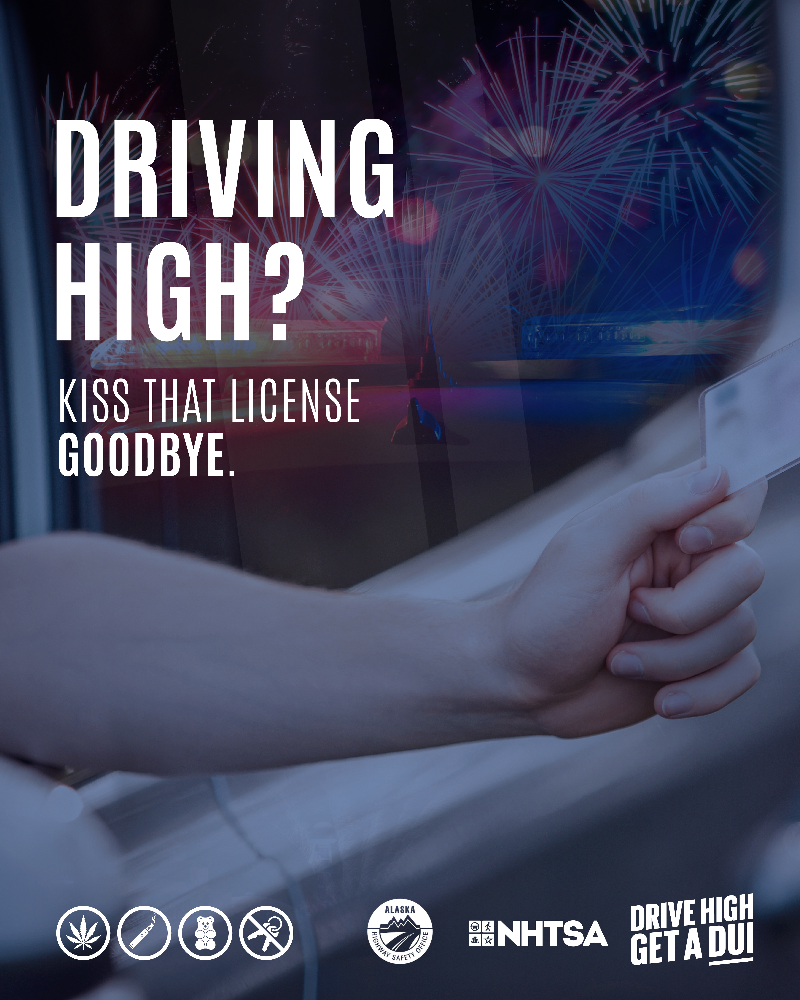

In [12]:
from PIL import Image, ImageOps

# 1. Load images - you have to upload these to Jupyter Notebook first or include a file path
photo = Image.open("drug-enforce-4th-of-july-goodbye-graphic-1080x1350-en-2025.png").convert("RGB") #Labeled wrong. 4500x5625
logo  = Image.open("AK_AHSO_Logo_Final_Knockout.png").convert("RGBA")   # keeps the transparency, 186x186

# 2. Resize logo 
scale_factor = 2                     # doubling the size of the logo, so now 372x372
new_size = (logo.width * scale_factor, logo.height * scale_factor)
logo = logo.resize(new_size, Image.LANCZOS)

# 3. Set coordinates for logo on the photo
margin_bottom = 200 # how far up from the bottom

x = (photo.width - logo.width) // 2              # centered horizontally
y = photo.height - logo.height - margin_bottom   # 572 px up from bottom - this is measured from the top down for some reason

# 4. Paste logo 
photo = photo.convert("RGBA")        
photo.paste(logo, (x, y), mask=logo)  # mask keeps transparency

# 5. Save / display 
photo.save("photo_with_logo1.png")    # PNG keeps transparency, if any
photo                                   # the result